In [4]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import networkx as nx
import plotly.graph_objects as go

In [5]:
trafficData = pd.read_csv('./SFlow_Data_1.csv', header=None)

trafficData.head()

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
0,FLOW,aa.aa.aa.aa,137,200,d404ff55fd4d,80711fc76001,0x0800,919.0,280,130.246.176.22,...,6,0x00,50,51216.0,23505,0x10,1518,1500,2048,NaN
1,FLOW,aa.aa.aa.aa,129,193,609c9f851b00,0031466b23cf,0x0800,11.0,919,155.69.160.32,...,6,0x00,56,23159.0,80,0x10,74,52,2048,NaN
2,FLOW,aa.aa.aa.aa,137,200,d404ff55fd4d,80711fc76001,0x0800,919.0,280,130.246.176.53,...,6,0x00,50,50041.0,20739,0x10,1518,1500,2048,NaN
3,FLOW,aa.aa.aa.aa,129,135,609c9f851b00,002688cd5fc7,0x0800,11.0,919,155.69.160.32,...,17,0x00,120,54241.0,26510,0x10,116,94,2048,NaN
4,FLOW,aa.aa.aa.aa,130,199,00239cd087c1,544b8cf9a7df,0x0800,919.0,600,137.132.228.15,...,6,0x00,56,53923.0,34262,0x10,70,52,2048,NaN


In [7]:
trafficData.columns = [
    'Type',
    'sflow_agent_address',
    'inputPort',
    'outputPort',
    'src_MAC',
    'dst_MAC',
    'ethernet_type',
    'in_vlan',
    'out_vlan',
    'src_IP',
    'dst_IP',
    'IP_protocol',
    'ip tos',
    'ip_ttl',
    'udp_src_port/tcp_src_port/icmp_type',
    'udp_dst_port/tcp_dst_port/icmp_code',
    'tcp_flags',
    'packet_size',
    'IP_size',
    'sampling_rate',
    'unknown',
]

trafficData

,Type,sflow_agent_address,inputPort,outputPort,src_MAC,dst_MAC,ethernet_type,in_vlan,out_vlan,src_IP,...,IP_protocol,ip tos,ip_ttl,udp_src_port/tcp_src_port/icmp_type,udp_dst_port/tcp_dst_port/icmp_code,tcp_flags,packet_size,IP_size,sampling_rate,unknown
0,FLOW,aa.aa.aa.aa,137,200,d404ff55fd4d,80711fc76001,0x0800,919.0,280,130.246.176.22,...,6,0x00,50,51216.0,23505,0x10,1518,1500,2048,NaN
1,FLOW,aa.aa.aa.aa,129,193,609c9f851b00,0031466b23cf,0x0800,11.0,919,155.69.160.32,...,6,0x00,56,23159.0,80,0x10,74,52,2048,NaN
2,FLOW,aa.aa.aa.aa,137,200,d404ff55fd4d,80711fc76001,0x0800,919.0,280,130.246.176.53,...,6,0x00,50,50041.0,20739,0x10,1518,1500,2048,NaN
3,FLOW,aa.aa.aa.aa,129,135,609c9f851b00,002688cd5fc7,0x0800,11.0,919,155.69.160.32,...,17,0x00,120,54241.0,26510,0x10,116,94,2048,NaN
4,FLOW,aa.aa.aa.aa,130,199,00239cd087c1,544b8cf9a7df,0x0800,919.0,600,137.132.228.15,...,6,0x00,56,53923.0,34262,0x10,70,52,2048,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69365,FLOW,aa.aa.aa.aa,258,199,204e71cf1b0f,ccef48570144,0x0800,537.0,601,207.241.228.157,...,6,0x00,56,443.0,57434,0x10,1522,1500,2048,NaN
69366,FLOW,aa.aa.aa.aa,131,193,00a742233e9e,0031466b23cf,0x0800,43.0,919,192.122.131.36,...,6,0x00,121,4920.0,443,0x10,1442,1420,2048,NaN
69367,FLOW,aa.aa.aa.aa,130,199,00239cd087c1,544b8cf9a7df,0x0800,919.0,600,137.132.228.15,...,6,0x00,56,34153.0,3123,0x10,82,64,2048,NaN
69368,FLOW,aa.aa.aa.aa,129,193,609c9f851b00,0031466b23cf,0x0800,11.0,919,155.69.196.9,...,17,0x00,58,56221.0,60786,0x10,1267,1245,2048,NaN


In [8]:
# remove CNTR type
trafficData = trafficData.set_index('Type').drop('CNTR', axis=0).reset_index()

trafficData

,Type,sflow_agent_address,inputPort,outputPort,src_MAC,dst_MAC,ethernet_type,in_vlan,out_vlan,src_IP,...,IP_protocol,ip tos,ip_ttl,udp_src_port/tcp_src_port/icmp_type,udp_dst_port/tcp_dst_port/icmp_code,tcp_flags,packet_size,IP_size,sampling_rate,unknown
0,FLOW,aa.aa.aa.aa,137,200,d404ff55fd4d,80711fc76001,0x0800,919.0,280,130.246.176.22,...,6,0x00,50,51216.0,23505,0x10,1518,1500,2048,NaN
1,FLOW,aa.aa.aa.aa,129,193,609c9f851b00,0031466b23cf,0x0800,11.0,919,155.69.160.32,...,6,0x00,56,23159.0,80,0x10,74,52,2048,NaN
2,FLOW,aa.aa.aa.aa,137,200,d404ff55fd4d,80711fc76001,0x0800,919.0,280,130.246.176.53,...,6,0x00,50,50041.0,20739,0x10,1518,1500,2048,NaN
3,FLOW,aa.aa.aa.aa,129,135,609c9f851b00,002688cd5fc7,0x0800,11.0,919,155.69.160.32,...,17,0x00,120,54241.0,26510,0x10,116,94,2048,NaN
4,FLOW,aa.aa.aa.aa,130,199,00239cd087c1,544b8cf9a7df,0x0800,919.0,600,137.132.228.15,...,6,0x00,56,53923.0,34262,0x10,70,52,2048,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68060,FLOW,aa.aa.aa.aa,258,199,204e71cf1b0f,ccef48570144,0x0800,537.0,601,207.241.228.157,...,6,0x00,56,443.0,57434,0x10,1522,1500,2048,NaN
68061,FLOW,aa.aa.aa.aa,131,193,00a742233e9e,0031466b23cf,0x0800,43.0,919,192.122.131.36,...,6,0x00,121,4920.0,443,0x10,1442,1420,2048,NaN
68062,FLOW,aa.aa.aa.aa,130,199,00239cd087c1,544b8cf9a7df,0x0800,919.0,600,137.132.228.15,...,6,0x00,56,34153.0,3123,0x10,82,64,2048,NaN
68063,FLOW,aa.aa.aa.aa,129,193,609c9f851b00,0031466b23cf,0x0800,11.0,919,155.69.196.9,...,17,0x00,58,56221.0,60786,0x10,1267,1245,2048,NaN


Exercise 4A: Top Talkers and Listeners

Top 5 Talkers

In [9]:
sourceDestIP = trafficData[['src_IP', 'dst_IP']]

topTalkers = sourceDestIP.pivot_table(index=['src_IP'], aggfunc='size').sort_values(ascending=False).to_frame()
topTalkers = topTalkers.reset_index()
topTalkers.columns = ['IP Address', 'No. of Packets']
topTalkers['Organisation'] = ""

for i in range(5):
    talkerIP = topTalkers['IP Address'][i]
    organisationData = pd.read_json('http://ip-api.com/json/'+str(talkerIP), typ='series')
    topTalkers.loc[i, 'Organisation'] = organisationData['org']
    if i in [4]:
        topTalkers.loc[i, 'Organisation'] = ' '.join(organisationData['as'].split(' ')[1:])
        

topTalkers.head()

,IP Address,No. of Packets,Organisation
0,193.62.192.8,3041,European Bioinformatics Institute
1,155.69.160.32,2975,Nanyang Technological University
2,130.14.250.11,2604,National Library of Medicine
3,14.139.196.58,2452,Indian Institute of Technology
4,140.112.8.139,2056,National Taiwan University


Top 5 Listeners

In [10]:
topListeners = sourceDestIP.pivot_table(index=['dst_IP'], aggfunc='size').sort_values(ascending=False).to_frame()
topListeners = topListeners.reset_index()
topListeners.columns = ['IP Address', 'No. of Packets']
topListeners['Organisation'] = ""

for i in range(5):
    listenerIP = topListeners['IP Address'][i]
    organisationData = pd.read_json('http://ip-api.com/json/'+str(listenerIP), typ='series')
    topListeners.loc[i, 'Organisation'] = organisationData['org']
    if i in [2]:
        topListeners.loc[i, 'Organisation'] = ' '.join(organisationData['as'].split(' ')[1:])

topListeners.head()

,IP Address,No. of Packets,Organisation
0,103.37.198.100,3841,A*STAR
1,137.132.228.15,3715,National University of Singapore
2,202.21.159.244,2446,Republic Polytechnic. Multihoming AS Singapore
3,192.101.107.153,2368,"Battelle Memorial Institute, Pacific Northwest..."
4,103.21.126.2,2056,Indian Institute of Technology Bombay


EXERCISE 4B: TRANSPORT PROTOCOL

In [11]:
ipProtocol = pd.DataFrame(trafficData['IP_protocol'].value_counts())
ipProtocol.columns = ['No. of Packets']

ipProtocol

,No. of Packets
6,56064
17,9462
50,1698
47,657
41,104
1,74
58,4
0,1
103,1


In [12]:
total = ipProtocol['No. of Packets'].sum()
TCPCount = ipProtocol['No. of Packets'].get(6)
UDPCount = ipProtocol['No. of Packets'].get(17)
othersCount = total-TCPCount-UDPCount

print('TCP Packets:', TCPCount, ', Percentage of TCP:', (TCPCount/total)*100, '%')
print('UDP Packets:', UDPCount, ', Percentage of UDP:', (UDPCount/total)*100, '%')
print('Other Packets:', othersCount, ', Percentage of Others:', (othersCount/total)*100, '%')

TCP Packets: 56064 , Percentage of TCP: 82.36832439579813 %
UDP Packets: 9462 , Percentage of UDP: 13.901417762432969 %
Other Packets: 2539 , Percentage of Others: 3.7302578417688976 %


EXERCISE 4C: APPLICATIONS PROTOCOL

In [13]:
destinationPort = pd.DataFrame(trafficData['udp_dst_port/tcp_dst_port/icmp_code'].value_counts())
destinationPort.columns = ['No. of Packets']

destinationPort.head()

,No. of Packets
443,13423
80,2647
52866,2068
45512,1356
56152,1341


EXERCISE 4D: TRAFFIC INTENSITY

In [14]:
totalPacketSize = trafficData['IP_size'].sum()
totalTraffic = ((totalPacketSize*1000)/(1024*1024))*15

print('Estimated Total Traffic Over 15 Seconds (MB):', totalTraffic)

Estimated Total Traffic Over 15 Seconds (MB): 926654.1767120361


EXERCISE 4E: ADDITIONAL ANALYSIS

Top 5 Communication Pair

In [15]:
commPairs = sourceDestIP.pivot_table(index=['src_IP', 'dst_IP'], aggfunc='size').sort_values(ascending=False).to_frame().reset_index()
commPairs.columns = ['Source IP', 'Destination IP', 'Count']
commPairs['Source Organisation'] = ""
commPairs['Destination Organisation'] = ""

for i in range(10):
    ip = commPairs['Source IP'][i]
    organisationData = pd.read_json('http://ip-api.com/json/'+str(ip), typ='series')
    commPairs.loc[i, 'Source Organisation'] = organisationData['org']
    if i in [3]:
        commPairs.loc[i, 'Source Organisation'] = ' '.join(organisationData['as'].split(' ')[1:])
    ip = commPairs['Destination IP'][i]
    organisationData = pd.read_json('http://ip-api.com/json/'+str(ip), typ='series')
    commPairs.loc[i, 'Destination Organisation'] = organisationData['org']

reorder = ['Source IP', 'Source Organisation', 'Destination IP', 'Destination Organisation', 'Count']
commPairs = commPairs.reindex(reorder, axis=1)
commPairs.head()

,Source IP,Source Organisation,Destination IP,Destination Organisation,Count
0,193.62.192.8,European Bioinformatics Institute,137.132.228.15,National University of Singapore,3041
1,130.14.250.11,National Library of Medicine,103.37.198.100,A*STAR,2599
2,14.139.196.58,Indian Institute of Technology,192.101.107.153,"Battelle Memorial Institute, Pacific Northwest...",2368
3,140.112.8.139,National Taiwan University,103.21.126.2,Indian Institute of Technology Bombay,2056
4,137.132.228.15,National University of Singapore,193.62.192.8,European Bioinformatics Institute,1910


Map of communication between different IPs

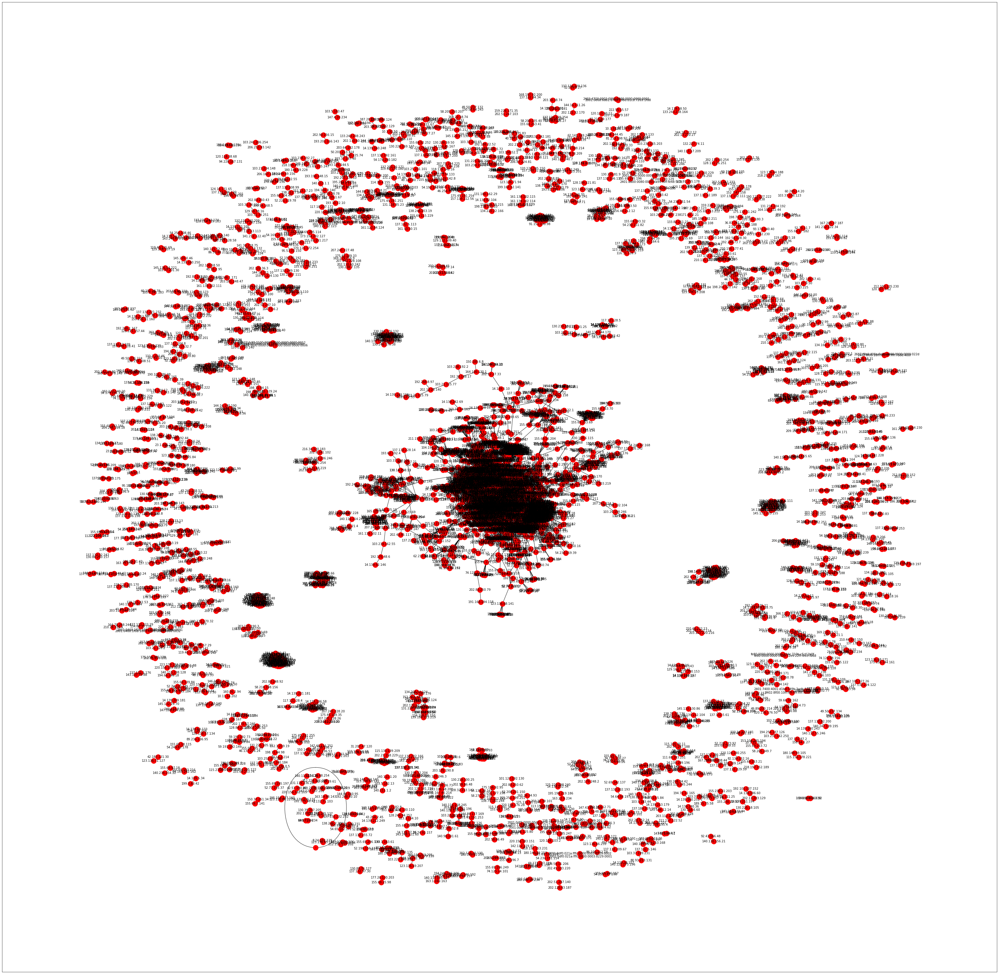

In [16]:
commDataset = pd.DataFrame({'from': commPairs['Source IP'], 'to': commPairs['Destination IP']})
G = nx.from_pandas_edgelist(commDataset, 'from', 'to')

plt.figure(figsize=(60,60))
gp = nx.spring_layout(G)
nx.draw_networkx_nodes(G, gp, node_color='red')
nx.draw_networkx_edges(G,gp)
nx.draw_networkx_labels(G,gp,font_size=10)

plt.show()

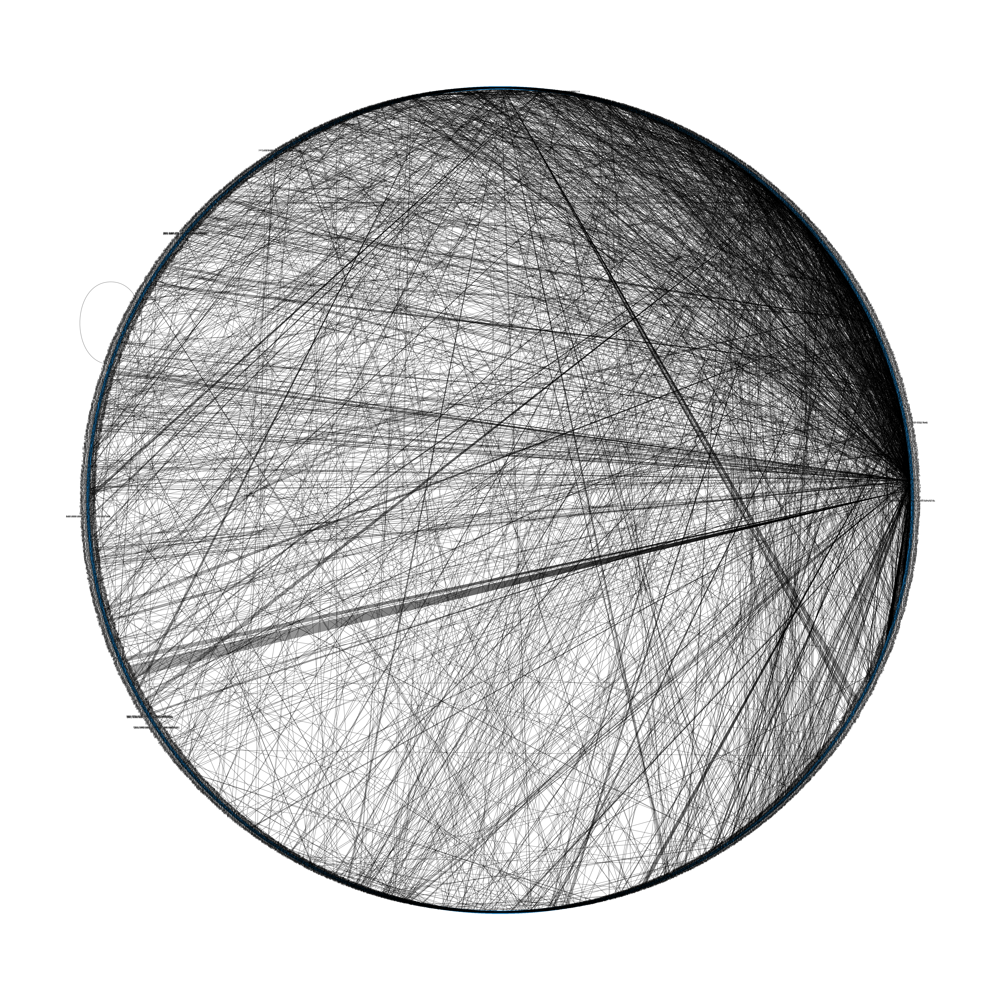

In [17]:
commDataset = pd.DataFrame({'from': commPairs['Source IP'], 'to': commPairs['Destination IP']})
G = nx.from_pandas_edgelist(commDataset, 'from', 'to')

plt.figure(5, figsize=(80,80))
nx.draw_circular(G, with_labels=True)
plt.show()

Sender IP Address        Count
193.62.192.8             3041      
155.69.160.32            2975      
130.14.250.11            2604      
-----------------------------------------
Sender IP Address:  193.62.192.8


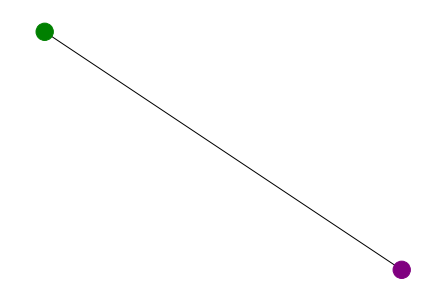

Sender IP Address:  155.69.160.32


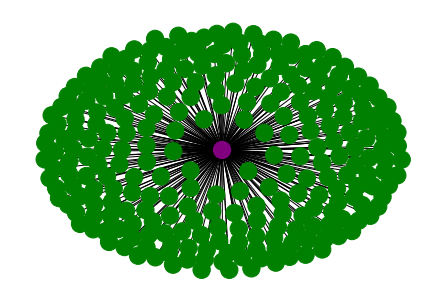

Sender IP Address:  130.14.250.11


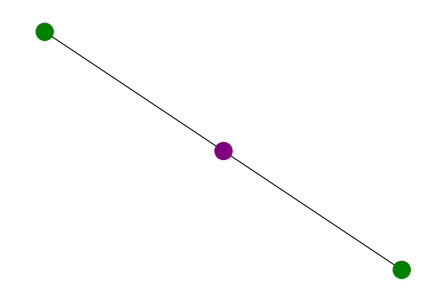

In [19]:
top3TalkersIP = trafficData['src_IP'].value_counts().head(3) 

print("{:<33}{:<10}".format('\033[1m' + "Sender IP Address" + '\033[0m','\033[1m' + "Count" + '\033[0m'))
for tip in top3TalkersIP.keys():
    print("{:<25}{:<10}".format(tip, top3TalkersIP[tip]))
    
print("===============================")

for tip in top3TalkersIP.keys():
    colors = []
    dfNet = trafficData.loc[trafficData['src_IP'] == tip]
    dfNet = dfNet[['src_IP', 'dst_IP']]
    print('Sender IP Address: ', tip)

    networkGraph = nx.Graph()
    networkGraph = nx.from_pandas_edgelist(dfNet, 'src_IP', 'dst_IP')
    
    for node in networkGraph:
        if node in tip:
            colors.append('purple') # For source IP (Talker)
        else:
            colors.append('green') # For destination IP
    
    nx.draw(networkGraph, with_labels=False, node_color=colors)
    plt.show()

Receiver IP Address      Count
103.37.198.100           3841      
137.132.228.15           3715      
202.21.159.244           2446      
Receiver IP Address:  103.37.198.100


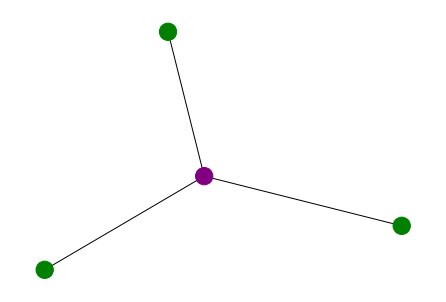

Receiver IP Address:  137.132.228.15


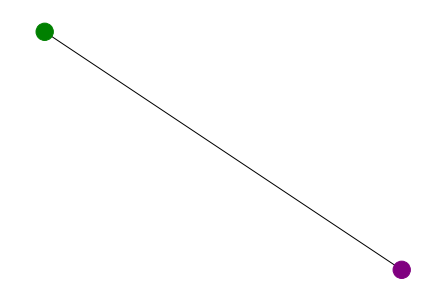

Receiver IP Address:  202.21.159.244


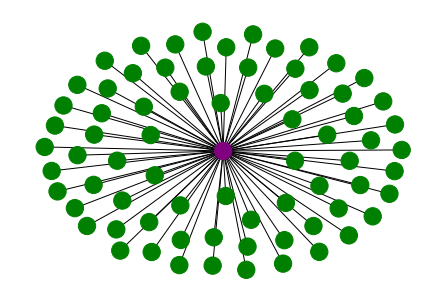

In [26]:
top3ListenersIP = trafficData['dst_IP'].value_counts().head(3) 
print("{:<33}{:<10}".format('\033[1m' + "Receiver IP Address" + '\033[0m','\033[1m' + "Count" + '\033[0m'))
for lip in top3ListenersIP.keys():
    print("{:<25}{:<10}".format(lip, top3ListenersIP[lip]))

print("===============================")

for lip in top3ListenersIP.keys():
    colors = []
    dfNet = trafficData.loc[trafficData['src_IP'] == lip]
    dfNet = dfNet[['src_IP', 'dst_IP']]
    print("Receiver IP Address: ", lip)

    networkGraph = nx.Graph()
    networkGraph = nx.from_pandas_edgelist(dfNet, 'src_IP', 'dst_IP')
    
    for node in networkGraph:
        if node in lip:
            colors.append('purple') # For source IP (Listener)
        else:
            colors.append('green') # For destination IP
            
    nx.draw(networkGraph, with_labels=False, node_color=colors)
    plt.show()

NTU Top Listener

In [25]:
topNtuListeners=trafficData.loc[trafficData["src_IP"].str.contains("155.69")].groupby(['dst_IP']).sum()['packet_size'].to_frame().sort_values('packet_size', ascending=False)
topNtuListeners = topNtuListeners.reset_index()


for i in range(5):
    listenerIP = topNtuListeners['dst_IP'][i]
    organisationData = pd.read_json('http://ip-api.com/json/'+str(listenerIP), typ='series')
    topNtuListeners.loc[i, 'Organisation'] = organisationData['org']

topNtuListeners.head()

,dst_IP,packet_size,Organisation
0,74.125.68.95,1300355,Google LLC
1,64.233.188.128,1224640,Google LLC
2,172.217.27.14,470167,Google LLC
3,74.125.200.95,322859,Google LLC
4,172.217.27.10,284921,Google LLC


Top NTU Talkers

In [24]:
topNtuTalkers = trafficData.loc[trafficData["dst_IP"].str.contains("155.69")].groupby(['src_IP']).sum()['packet_size'].to_frame().sort_values('packet_size', ascending=False)
topNtuTalkers = topNtuTalkers.reset_index()
for i in range(5):
    talkerIP = topNtuTalkers['src_IP'][i]
    organisationData = pd.read_json('http://ip-api.com/json/'+str(talkerIP), typ='series')
    topNtuTalkers.loc[i, 'Organisation'] = organisationData['org']
    if i in [0, 2]:
        topNtuTalkers.loc[i, 'Organisation'] = ' '.join(organisationData['as'].split(' ')[1:])

topNtuTalkers.head()

,src_IP,packet_size,Organisation
0,202.120.224.114,1184116,China Education and Research Network Center
1,152.3.137.246,436814,Duke University
2,133.24.248.17,267872,Yamagata University
3,137.222.0.78,171806,University of Bristol
4,72.233.250.16,152852,Washington State K-20 Telecommunications Network
